In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import vmo.analysis as van
import vmo.generate as vge
import matplotlib.pyplot as plt
import sklearn.preprocessing as pre
import librosa, vmo, pickle
import IPython.display
%matplotlib inline

In [47]:
target_file = '../files/tenor_sax.wav'

fft_size = 8192*4
hop_size = fft_size/2

## Process the Origin Audio File

In [57]:
y, sr = librosa.load(target_file, sr = 44100)
C = librosa.feature.chromagram(y=y, sr=sr, n_fft=fft_size, hop_length=hop_size, octwidth = None)
feature = np.log(C+np.finfo(float).eps)
feature = pre.normalize(feature)
# feature = pre.normalize(C)

In [58]:
IPython.display.Audio(data=y, rate=sr)

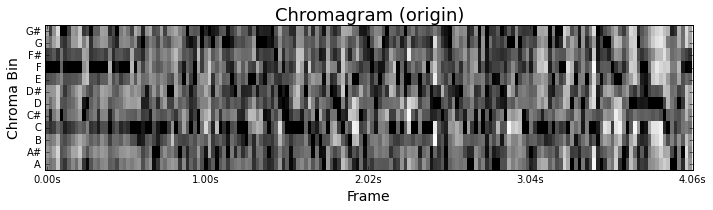

In [59]:
plt.figure(figsize = (10,3))
librosa.display.specshow(feature, aspect = 'auto', origin = 'lower', interpolation = 'nearest'
                         ,cmap ='Greys', y_axis='chroma', x_axis='time')
plt.title('Chromagram (origin)', fontsize = 18)
plt.xlabel('Frame', fontsize = 14)
plt.ylabel('Chroma Bin', fontsize = 14)
plt.tight_layout()

In [60]:
chroma_frames = feature.transpose()
r = (0.0, 0.25, 0.001) 
ideal_t = vmo.find_threshold(chroma_frames, r = r,flag = 'a',VERBOSE = False)
oracle_t = vmo.build_oracle(chroma_frames, flag = 'a', 
                            threshold = ideal_t[0][1], 
                            feature = 'chroma')

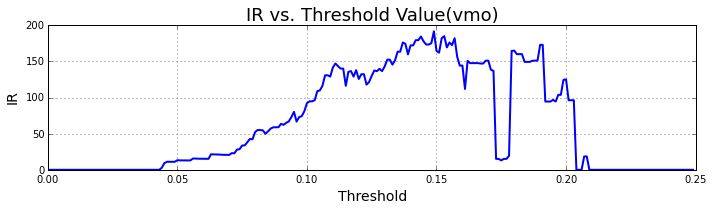

In [61]:
x = np.array([i[1] for i in ideal_t[1]])
y = [i[0] for i in ideal_t[1]]
fig = plt.figure(figsize = (10,3))
plt.plot(x, y, linewidth = 2)
plt.title('IR vs. Threshold Value(vmo)', fontsize = 18)
plt.grid(b = 'on')
plt.xlabel('Threshold', fontsize = 14)
plt.ylabel('IR', fontsize = 14)
plt.xlim(0,0.25)
plt.tight_layout()

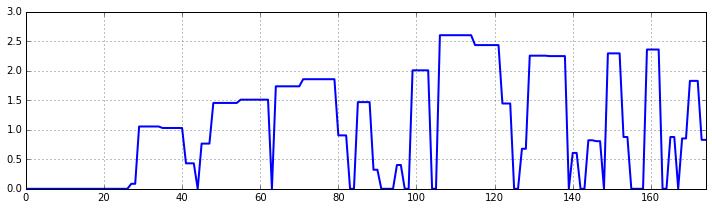

In [62]:
plt.figure(figsize = (10,3))
ir, h0, h1 = oracle_t.IR()
plt.plot(ir, linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_t.n_states-2)
plt.tight_layout()

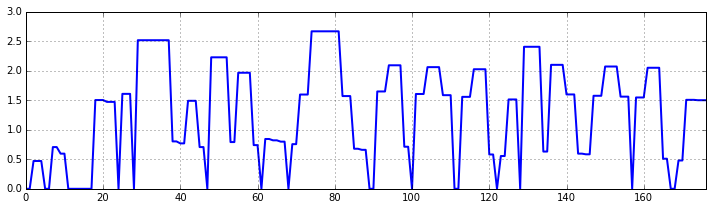

In [63]:
seq = vge.improvise(oracle_t, seq_len = oracle_t.n_states-1, LRS = 2, weight = 'lrs')
x, _w = vge.audio_synthesis(target_file, 'vmo_synthesis_test.wav', seq, 
                            buffer_size = fft_size, hop = hop_size)
C_x = librosa.feature.chromagram(y=x, sr=sr, n_fft=fft_size, hop_length=hop_size, octwidth = None)
feature_x = np.log(C_x+np.finfo(float).eps)
feature_x = pre.normalize(feature_x)
chroma_frames_x = feature_x.transpose()
oracle_x = vmo.build_oracle(chroma_frames_x, flag = 'a', 
                            threshold = ideal_t[0][1], 
                            feature = 'chroma')

plt.figure(figsize = (10,3))
ir_x, h0, h1 = oracle_x.IR()
plt.plot(ir_x, linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_x.n_states-2)
plt.tight_layout()

In [64]:
IPython.display.Audio(data=x, rate=sr)

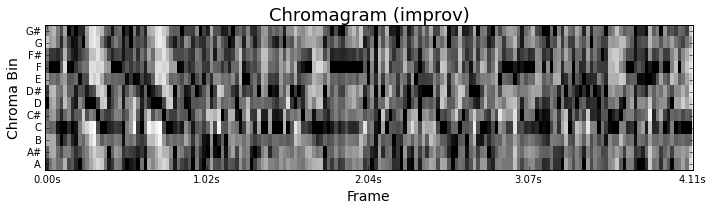

In [65]:
plt.figure(figsize = (10,3))
librosa.display.specshow(feature_x, aspect = 'auto', origin = 'lower', interpolation = 'nearest'
                         ,cmap ='Greys', y_axis='chroma', x_axis='time')
plt.title('Chromagram (improv)', fontsize = 18)
plt.xlabel('Frame', fontsize = 14)
plt.ylabel('Chroma Bin', fontsize = 14)
plt.tight_layout()

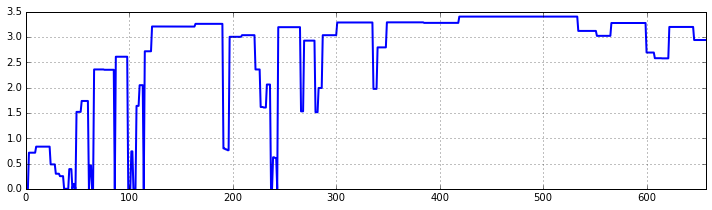

In [44]:
x, _w = vge.generate_audio(target_file, 'vmo_synthesis_test.wav', 
                         buffer_size = fft_size, hop = hop_size, oracle = oracle_t, 
                         seq_len = oracle_t.n_states-1, p = 0.9, k = 1, lrs = 0)
C_x = librosa.feature.chromagram(y=x, sr=sr, n_fft=fft_size, hop_length=hop_size, octwidth = None)
feature_x = np.log(C_x+np.finfo(float).eps)
feature_x = pre.normalize(feature_x)
chroma_frames_x = feature_x.transpose()
oracle_x = vmo.build_oracle(chroma_frames_x, flag = 'a', 
                            threshold = ideal_t[0][1], 
                            feature = 'chroma')

plt.figure(figsize = (10,3))
ir_x, h0, h1 = oracle_x.IR()
plt.plot(ir_x, linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_x.n_states-2)
plt.tight_layout()
IPython.display.Audio(data=x, rate=sr)